# Day 3: Linear Mixed Effect Models: Bibliometrics case study

* "Trends in data science" time series data from PubMed
    * Can also use Google Scholar, Web of Science
* Research Question: what are the hot topics these days in data science
* Methodology: Use mixed model to measure rate of increase of mentions in PubMed

## References

* [Roeback P. & Legler J., 2021 - Beyond Multiple Linear Regression](https://bookdown.org/roback/bookdown-BeyondMLR/)
* [Midway D., 2022 - Data Analysis in R](https://bookdown.org/steve_midway/DAR/random-effects.html) - Chapter 9 Random Effects

In [1]:
.Library

[1] "/opt/anaconda3/envs/CondaRplotly/lib/R/library"

In [2]:
# install.packages( "plotly" )
# install.packages( "magrittr" )
# install.packages( "lmerTest" )

In [3]:
library( tidyverse )

── Attaching packages ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────── tidyverse 1.3.1 ──

✔ ggplot2 3.3.5     ✔ purrr   0.3.4
✔ tibble  3.1.6     ✔ dplyr   1.0.8
✔ tidyr   1.2.0     ✔ stringr 1.4.0
✔ readr   2.1.2     ✔ forcats 0.5.1

── Conflicts ─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()



In [4]:
# Import this to use the "double-ended pipe" i.e., %<>%
library( magrittr )


Attaching package: ‘magrittr’


The following object is masked from ‘package:purrr’:

    set_names


The following object is masked from ‘package:tidyr’:

    extract




In [5]:
# # Download data time series data of topic mentions per year

# files <- fs::dir_ls( path = "pubmed_data", glob = "*csv" )

# as.character( files )

# length( files )

# PreviewFile <- function( filepath )
# {
#     filepath %>%
#         readLines %>%
#         head( 10 ) %>%
#         paste( collapse="\n" ) %>%
#         cat
# }

# PreviewFile( 'pubmed_data/anova.csv' )

# PreviewFile( 'pubmed_data/artificial_intelligence.csv'  )

# # Load time series data into a single data frame

# data <- readr::read_csv( files, id="Topic", skip=1 )

# glimpse( data )

# sample_n( data, 10 )

# ## Make the topics look pretty

# PrettifyTopic <- function( raw )
# {
#     filenames <- str_split_fixed( raw, "/", n=2 ) [,2]
#     #head( filenames )
#     raw_topics <- str_split_fixed( filenames, "\\.", n=2 )[,1]
#     #sample( raw_topics, 5 )
#     topics <- str_replace_all( raw_topics, "_", " " )
#     #sample( topics, 5 )
#     cap_topics <- str_to_title( topics )
#     #sample( cap_topics, 5 )
#     return( cap_topics )
# }

# data$Topic <- PrettifyTopic( data$Topic )

# data %>%
#     write_csv( "pubmed_data_science_mentions.csv" )

In [6]:
data <- readr::read_csv( "pubmed_data_science_mentions.csv" )

Rows: 2730 Columns: 3
── Column specification ─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: ","
chr (1): Topic
dbl (2): Year, Count

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [7]:
sample_n( data, 10 )

Topic,Year,Count
<chr>,<dbl>,<dbl>
Ensemble Methods,1990,32
Generalized Additive Models,2004,2508
Deep Learning,1985,5
Nonlinear Regression,1980,18
Clustering Model,1985,163
Clustering Model,1992,404
Imputation Missing,2019,561
Negative Binomial,1977,4
Linear Mixed Model,2007,591


In [8]:
dim( data )

[1] 2730    3

## Drop all data points before 1975, and with less than 10 mentions per year

In [9]:
data %<>%
    filter( Year > 1975 ) %>%
    filter( Count >= 10 )

In [10]:
dim( data )

[1] 1938    3

In [11]:
sample_n( data, 10 )

Topic,Year,Count
<chr>,<dbl>,<dbl>
Heteroscedascity,2010,31
Decision Tree,1988,62
Model Selection,2001,47
Linear Regression,2014,18017
Stepwise Regression,2018,1789
Generalized Estimating Equations,2021,3006
Regression Model,2003,6730
Clustering Model,2000,1249
Dimensionality Reduction,2016,1490


In [12]:
data$Topic %>% unique %>% sort

[1] "Anova"                            "Artificial Intelligence"         
 [3] "Autoregressive Models"            "Bayesian Analysis"               
 [5] "Clustering Model"                 "Cross-Validation"                
 [7] "Decision Tree"                    "Deep Learning"                   
 [9] "Dimensionality Reduction"         "Discriminant Analysis"           
[11] "Embedding"                        "Ensemble Methods"                
[13] "Feature Selection"                "Gaussian Process"                
[15] "Generalized Additive Models"      "Generalized Estimating Equations"
[17] "Generalized Linear Model"         "Gradient Descent"                
[19] "Hazard Ratio"                     "Heteroscedascity"                
[21] "Hyperparameter"                   "Imputation Missing"              
[23] "Kruskal-Wallis"                   "Linear Mixed Model"              
[25] "Linear Models"                    "Linear Regression"               
[27] "Logistic Regression"              "Longitudinal Data Analysis"      
[29] "Machine Learning"                 "Matrix Decomposition"            
[31] "Model Selection"                  "Multiple Regression"             
[33] "Naive Bayes"                      "Natural Language Processing"     
[35] "Nearest Neighbor"                 "Negative Binomial"               
[37] "Neural Network"                   "Nonlinear Regression"            
[39] "Poisson Regression"               "Principle Component"             
[41] "Random Forest"                    "Regression Model"                
[43] "Regularized Regression"           "Simulated Data"                  
[45] "Stepwise Regression"              "Support Vector Machine"          
[47] "T-Test"                           "Trajectory Analysis"             
[49] "Variable Selection"

## Extrapolate out mentions in the year 2022 to a full year's worth

In [13]:
library( lubridate )


Attaching package: ‘lubridate’


The following objects are masked from ‘package:base’:

    date, intersect, setdiff, union




In [14]:
today <- ymd( "2022-04-15" )

In [15]:
first_of_year <- ymd( "2022-01-01" )

In [16]:
n_days <- interval( first_of_year, today ) %>%
    as.numeric( 'days' )

In [17]:
n_days

[1] 104

In [18]:
multiplier <- 365 / n_days

In [19]:
multiplier

[1] 3.509615

In [20]:
Extrapolate_Count <- function( val ) {
    return( as.integer( round( val * multiplier ) ) )
}

In [21]:
head( data[ data$Year == 2022, ] )

Topic,Year,Count
<chr>,<dbl>,<dbl>
Anova,2022,5932
Artificial Intelligence,2022,9684
Autoregressive Models,2022,378
Bayesian Analysis,2022,1826
Clustering Model,2022,3668
Cross-Validation,2022,1323


In [22]:
data[ data$Year == 2022, ]$Count %<>%
    Extrapolate_Count

In [23]:
head( data[ data$Year == 2022, ] )

Topic,Year,Count
<chr>,<dbl>,<dbl>
Anova,2022,20819
Artificial Intelligence,2022,33987
Autoregressive Models,2022,1327
Bayesian Analysis,2022,6409
Clustering Model,2022,12873
Cross-Validation,2022,4643


# Quick and dirty raw counts (non-interactive) plot with ggplot

In [24]:
options(
    repr.plot.width=10,
    repr.plot.height=6,
    repr.plot.res=300
)

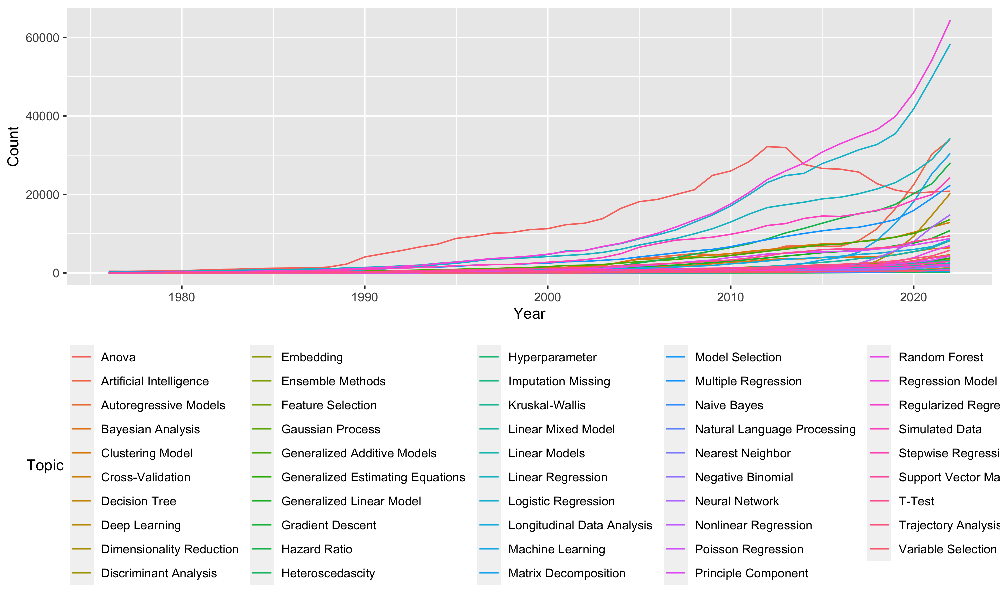

In [25]:
data %>%
    ggplot( aes( x=Year, y=Count, color=Topic)  ) +
    geom_line() + theme(legend.position="bottom")
    #geom_smooth(method = "loess")

# Take log base 10 of counts

In [26]:
data %<>%
    mutate(
        log10_Count = log( Count, base=10 )
    )

In [27]:
head( data )

Topic,Year,Count,log10_Count
<chr>,<dbl>,<dbl>,<dbl>
Anova,2022,20819,4.318460
Anova,2021,20627,4.314436
Anova,2020,20312,4.307753
Anova,2019,21114,4.324571
Anova,2018,22729,4.356580
Anova,2017,25685,4.409680


In [28]:
options(
    repr.plot.width=10,
    repr.plot.height=6,
    repr.plot.res=300
)

# Spaghetti plot of log mentions versus time

`geom_smooth()` using formula 'y ~ x'



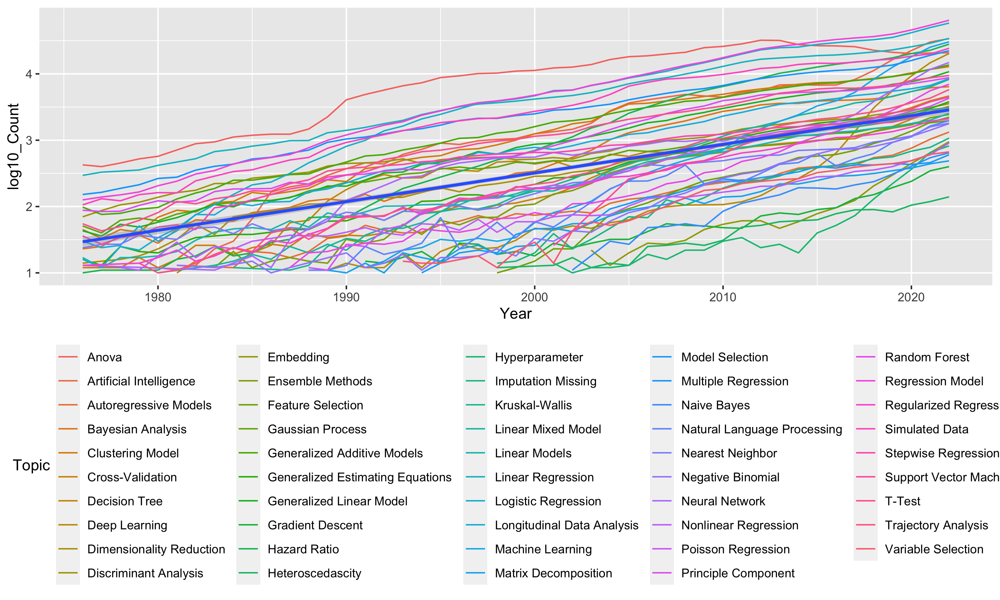

In [29]:
data %>%
    ggplot(
        aes( x=Year, y=log10_Count )
    ) +
    geom_line( aes( color=Topic ) ) + 
    geom_smooth( method = "lm" ) +
    theme( legend.position="bottom" )

# Create interactive Spaghetti plot

In [30]:
# library(rbokeh)

# fig <- rbokeh::figure(width = 1200, height = 600) %>%
#   ly_lines(
#       x=Year,
#       y=log_mentions,
#       color=Topic,
#       hover=Topic,
#       data=data)#, legend = "lowess")

# fig

In [31]:
library( plotly )


Attaching package: ‘plotly’


The following object is masked from ‘package:ggplot2’:

    last_plot


The following object is masked from ‘package:stats’:

    filter


The following object is masked from ‘package:graphics’:

    layout




In [32]:
fig <- data %>%
    plot_ly(
        x = ~Year,
        y = ~log10_Count,
        color = ~Topic,
        type = 'scatter',
        mode = 'lines'
    )

In [33]:
fig

Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”


HTML widgets cannot be represented in plain text (need html)

# Reparameterize X-axis to facilitate estimate of within-subject slope and intercept

* Convert calendar years to time
* Three options
    * "Entry time" => time = current year - FIRST year of study
    * "Centered time" => time = current year - MIDPOINT year of study
    * "Exit time" => time = current year - LAST year of study   
* Timepoint that you put the "Year 0" is where the within-subject estimates for slope and intercept will be
    * Analogy: "Year 0" is like manual focus of a camera

In [34]:
glimpse( data )

Rows: 1,938
Columns: 4
$ Topic       <chr> "Anova", "Anova", "Anova", "Anova", "Anova", "Anova", "Ano…
$ Year        <dbl> 2022, 2021, 2020, 2019, 2018, 2017, 2016, 2015, 2014, 2013…
$ Count       <dbl> 20819, 20627, 20312, 21114, 22729, 25685, 26420, 26615, 27…
$ log10_Count <dbl> 4.318460, 4.314436, 4.307753, 4.324571, 4.356580, 4.409680…


In [35]:
ReparameterizeXaxis <- function( df, Xvar_name )
# Add three columns to the data frame representing
# the three time reparameterization options.
{
    X <- df[[ Xvar_name ]]
    first_year <- min( X ) 
    last_year <- max( X )
    mean_year <- mean( c( first_year, last_year ) )
    df %>%
        mutate(
            centered_time = X - mean_year,
            entry_time = X - first_year,
            exit_time = X - last_year,
        ) %>%
        return
}

In [36]:
min( data$Year )

[1] 1976

In [37]:
max( data$Year )

[1] 2022

In [38]:
mean( c( min( data$Year ), max( data$Year ) ) )

[1] 1999

# Interactive plot with the time reparameterization

In [39]:
data %>%
    ReparameterizeXaxis( "Year" ) %>%
    plot_ly(
        x = ~centered_time,
        #x = ~entry_time,
        #x = ~exit_time,
        y = ~log10_Count,
        color = ~Topic,
        type = 'scatter',
        mode = 'lines'
    )

Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”


HTML widgets cannot be represented in plain text (need html)

# First model: Plain old linear model

* A plain linear model in the form of $Y = mx + b$ uses 3 parameters to explain the variance observed in the data:
* More specifically: $log( \textrm{Count} ) = \beta_1 \cdot \textrm{ time } + \beta_0 + \boldsymbol{\epsilon}$ 
* LM OUTPUTS:
    1. $\beta_0$ = Population intercept, aka $b$
    2. $\beta_1$ = Population slope, aka $m$
    3. $\epsilon$ = Residuals (noise) where $\epsilon = \mathcal{N}(0,\sigma^2_{\textrm{noise}})$

In [40]:
LM_model <- data %>%
    ReparameterizeXaxis( "Year" ) %>%
    lm( log10_Count ~ 1 + centered_time, data=. )

In [41]:
summary( LM_model )


Call:
lm(formula = log10_Count ~ 1 + centered_time, data = .)

Residuals:
    Min      1Q  Median      3Q     Max 
-1.8098 -0.4980 -0.0105  0.4885  1.6542 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)   2.462852   0.015760  156.27   <2e-16 ***
centered_time 0.043201   0.001205   35.86   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.6787 on 1936 degrees of freedom
Multiple R-squared:  0.3992,	Adjusted R-squared:  0.3988 
F-statistic:  1286 on 1 and 1936 DF,  p-value: < 2.2e-16


## Residuals tell us how well our 2-param linear model describes our data

In [42]:
sd( residuals( LM_model ) )

[1] 0.6785329

In [43]:
summary( residuals( LM_model ) )

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
-1.8098 -0.4980 -0.0105  0.0000  0.4886  1.6542 

# Second model: Linear mixed effects model

* Mixed effects models are "mixed" because there are "fixed effects" (population-wide effects) plus "random effects" (group-level effects)
* Random effects are used when the group levels can be conceptualized as random pulls from a larger population of groups. 
    * Here we model the 46 data science topics as a random effect.
* Mixed effects models are GREAT for missing data!
    * "Partial pooling" = For groups/individuals that have less within-subject data points, algorithm will "shrink" their within-subject slope/intercept estimates towards the population slope/intercept.
* $\boldsymbol{y} = X \boldsymbol{\beta} + Z \boldsymbol{u} + \boldsymbol{\epsilon}$
* Mixed effect models uses 6 total parameters to explain the variance observed in the data
* LMM INPUTS
    * Same as LM:
        * $X$ is reparameterized time and $\boldsymbol{y}$ is $log(Count)$ as in linear model
    * New:
        * $Z$ is the grouping variable, aka subject, participant, location, etc.
* LMM OUTPUTS:
    * Same as LM
        1. Population intercept ($\beta_0$ point estimate)
        2. Population slope ($\beta_1$ point estimate)
        3. Residuals $\epsilon \sim  \mathcal{N}(0,\sigma^2_{\textrm{noise}})$
    * NEW: $\boldsymbol{u}$ are OUTPUT: the "random effect" estimates. In our case each data science topic will get their own within-subject ("personalized") intercept, and  within-subject slope which are deviations from the fixed effects.
        1. Within-subject intercept ($u_0 \sim \mathcal{N}(0,\sigma^2_{\textrm{intercept}})$)
        2. Within-subject slope ($u_1 \sim \mathcal{N}(0,\sigma^2_{\textrm{slope}})$)
        3. Correlation between within-subject slopes and within-subject intercepts $\rho$


## LMM formula syntax

* Specify outcome or Y variable on left side of tilde
* Predictor variables, both fixed and random effects go on the right side of the tilde
* Models are always fitted with intercepts unless you tell it not to
    * You can add the "+ 1" to the formula to make it explicit that you're getting intercepts
    * If you *don't* want the model to fit intercepts you must add "- 1" to your formula
* Fixed effect covariates are declared in your model just like lm syntax
    * This includes interaction terms, e.g., "Age * time" is equivalent to "Age + time + Age:time", where "Age:time" is a multiplicative interaction term
* Random effects are added to the model inside parentheses
    * The grouping variable is specified using single pipe ("|") or double pipe ("||") operators
    * Single pipe implies a random effect intercepts and slopes are correlated and for the model to parameterize (estimate) their correlation
    * Double pipe implies no correlation expected between random effect slopes and intercepts
    * E.g.,
        * ( 1 | idno) = Estimate random effect intercepts for each individual as defined in the "idno" column in your data frame.
        * ( 1 | batchno ) = Estimate random effect intercepts for each batch as defined in the "batch" column in your data frame.
        * ( centered_time | ID ) = Estimate random effect intercepts AND slopes for each individual as defined in the "ID" column in your data frame (remember intercepts are always fitted unless you tell it not to, even for random effects). Assume slopes and ints are correlated and estimate their correlation.
        * ( centered_time || ID ) = Estimate random effect intercepts AND slopes for each individual as defined in the "ID" column in your data frame, while assuming that ranef slopes and intercepts don't have a covariance relationship (are not correlated)
        * ( centered_time - 1 | ID ) = Estimate random effect slopes ONLY for each individual as defined in the "ID" column in your data frame

In [44]:
# 2017 Paper for lmerTest has over 9,000 citations!
library( lmerTest )

Loading required package: lme4

Loading required package: Matrix


Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack



Attaching package: ‘lmerTest’


The following object is masked from ‘package:lme4’:

    lmer


The following object is masked from ‘package:stats’:

    step




In [45]:
LMixed_model <- data %>%
    ReparameterizeXaxis( "Year" ) %>%
    #lmer( log10_Count ~ 1 + centered_time + (1 + centered_time | Topic), data=. ) # Parameterize using correlated slopes/ints
    lmer( log10_Count ~ 1 + centered_time + (1 + centered_time || Topic), data=. ) # Parameterize using UNcorrelated slopes/ints

In [46]:
# compare to that of straight LM above
sd( residuals( LMixed_model ) )

[1] 0.135433

In [47]:
# compare to that of straight LM above
summary( residuals( LMixed_model ) )

     Min.   1st Qu.    Median      Mean   3rd Qu.      Max. 
-0.616694 -0.070284  0.005247  0.000000  0.072756  0.797670 

In [48]:
LMixed_model
#summary( LMixed_model )

Linear mixed model fit by REML ['lmerModLmerTest']
Formula: log10_Count ~ 1 + centered_time + (1 + centered_time || Topic)
   Data: .
REML criterion at convergence: -1587.657
Random effects:
 Groups   Name          Std.Dev.
 Topic    (Intercept)   0.76054 
 Topic.1  centered_time 0.01653 
 Residual               0.13892 
Number of obs: 1938, groups:  Topic, 49
Fixed Effects:
  (Intercept)  centered_time  
      2.24609        0.05979  

In [49]:
# Here's a differen't way to represent the outputs:
# library( broom.mixed )
# LMixed_model %>% tidy

# Interclass Correlation Coefficient (ICC)

* A measure of how important the group id's are
* Quantifies variability between groups versus variability among groups
* $ICC \approx 0$ means group information not important
* $ICC \approx 1$ means group information VERY important
* ICC for ranef intercept: $ICC = \dfrac{ \sigma^2_{\textrm{intercept}} }{ \sigma^2_{\textrm{residual}} + \sigma^2_{\textrm{intercept}} } = \dfrac{ 0.763 }{ 0.763 + 0.139 } = 0.84$
* Important: ICC is great for LMM, but is not applicable for GLMM

# Interpretation of fixed effects

In [50]:
fixef( LMixed_model )

(Intercept) centered_time 
   2.24609277    0.05979378

In [51]:
10**fixef( LMixed_model )

(Intercept) centered_time 
   176.235245      1.147609

In [52]:
( 10**fixef( LMixed_model )[[ 'centered_time' ]] ) * 100

[1] 114.7609

# Examining random effect estimates using <code>ranef()</code> function

In [53]:
LMixed_model %>%
    ranef() %>%
    pluck( "Topic" ) %>%
    head

,(Intercept),centered_time
,<dbl>,<dbl>
Anova,1.56186486,-0.0168035928
Artificial Intelligence,0.67929489,0.0110997214
Autoregressive Models,-0.36866954,-0.0142395487
Bayesian Analysis,0.39084268,-0.0032707321
Clustering Model,0.72725048,-0.0018864443
Cross-Validation,-0.03342893,-0.0006399497


# Diagnostics resources

* Diagnostics and Inference:
    * https://www.ssc.wisc.edu/sscc/pubs/MM/MM_DiagInfer.html
* Residual analysis for mixed models
    * https://www.ime.usp.br/~jmsinger/MAE0610/Mixedmodelresiduals.pdf
* Mixed Model diagnostics
    * https://dfzljdn9uc3pi.cloudfront.net/2020/9522/1/MixedModelDiagnostics.html
* qqnorm.lme
    * https://rdrr.io/cran/nlme/man/qqnorm.lme.html

# Piecewise (Segmented) Regression: Data science trends in '02-'12 versus '12-'22

* Goal: compare trajectories of topic mentions in PubMed from 2 decades ago versus the last decade
* Method: Extract within-subject random effects estimates for slopes from each LMM and do scatter plot
* Notably there is no p-value associated with random effect estimates for slope and intercept

In [54]:
model2002to2012 <- data %>%
    filter( Year >= 2002, Year <= 2012 ) %>%
    ReparameterizeXaxis( "Year" ) %>%
    lmer( log10_Count ~ 1 + centered_time + (1 + centered_time | Topic), data=. )
    #lmer( log10_Count ~ 1 + exit_time + (1 + exit_time | Topic), data=. )

In [55]:
model2012to2022 <- data %>%
    filter( Year >= 2012, Year <= 2022 ) %>%
    ReparameterizeXaxis( "Year" ) %>%
    lmer( log10_Count ~ 1 + centered_time + (1 + centered_time | Topic), data=. )
    #lmer( log10_Count ~ 1 + exit_time + (1 + exit_time | Topic), data=. )

In [56]:
model2002to2012
#summary( model2002to2012 )

Linear mixed model fit by REML ['lmerModLmerTest']
Formula: log10_Count ~ 1 + centered_time + (1 + centered_time | Topic)
   Data: .
REML criterion at convergence: -1083.497
Random effects:
 Groups   Name          Std.Dev. Corr 
 Topic    (Intercept)   0.74658       
          centered_time 0.02197  -0.25
 Residual               0.05406       
Number of obs: 537, groups:  Topic, 49
Fixed Effects:
  (Intercept)  centered_time  
      2.74711        0.06252  

In [57]:
model2012to2022
#summary( model2012to2022 )

Linear mixed model fit by REML ['lmerModLmerTest']
Formula: log10_Count ~ 1 + centered_time + (1 + centered_time | Topic)
   Data: .
REML criterion at convergence: -1109.468
Random effects:
 Groups   Name          Std.Dev. Corr 
 Topic    (Intercept)   0.66083       
          centered_time 0.04161  -0.34
 Residual               0.05019       
Number of obs: 539, groups:  Topic, 49
Fixed Effects:
  (Intercept)  centered_time  
      3.29435        0.05823  

In [58]:
GrabRanefs <- function( model, ranef_name ) {
    ranefs <- model %>%
        ranef %>%
        pluck( "Topic" ) %>%
        rownames_to_column
    ranef_estimates <- ranefs[[ ranef_name ]]
    names( ranef_estimates ) <- ranefs$rowname
    return( ranef_estimates )
}

In [59]:
model2002to2012

Linear mixed model fit by REML ['lmerModLmerTest']
Formula: log10_Count ~ 1 + centered_time + (1 + centered_time | Topic)
   Data: .
REML criterion at convergence: -1083.497
Random effects:
 Groups   Name          Std.Dev. Corr 
 Topic    (Intercept)   0.74658       
          centered_time 0.02197  -0.25
 Residual               0.05406       
Number of obs: 537, groups:  Topic, 49
Fixed Effects:
  (Intercept)  centered_time  
      2.74711        0.06252  

In [60]:
old_trajectories <- GrabRanefs( model2002to2012, "centered_time" )
#old_trajectories <- GrabRanefs( model2002to2012, "exit_time" )

In [61]:
head( old_trajectories )

Anova Artificial Intelligence   Autoregressive Models 
           -0.023689444            -0.010580128            -0.008786765 
      Bayesian Analysis        Clustering Model        Cross-Validation 
            0.012668594            -0.011979707             0.007125658

In [62]:
new_trajectories <- GrabRanefs( model2012to2022, "centered_time" )
#new_trajectories <- GrabRanefs( model2012to2022, "exit_time" )

In [63]:
head( new_trajectories )

Anova Artificial Intelligence   Autoregressive Models 
           -0.078969982             0.023471085             0.006270005 
      Bayesian Analysis        Clustering Model        Cross-Validation 
           -0.030542770            -0.026269174             0.004899563

In [64]:
all_slopes <- data.frame(
        old_trajectories,
        new_trajectories
    )

In [65]:
all_slopes <- ( 10**all_slopes ) * 100

# Ranef Slopes = topic "velocities" relative to group mean rate of change

In [66]:
all_slopes %>%
    rownames_to_column( "Topic" ) %>%
    plot_ly(
        x = ~old_trajectories,
        y = ~new_trajectories,
        color = ~Topic,
        type = 'scatter'
    ) %>%
    layout( 
        title = 'Decade-to-decade differences in rates of change of data science topic mentions in PubMed',
        xaxis = list( title = '2002-12 % increase relative to baseline' ), 
        yaxis = list( title = '2012-22 % increase relative to baseline' )
    )

No scatter mode specifed:
  Setting the mode to markers
  Read more about this attribute -> https://plotly.com/r/reference/#scatter-mode

Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”
No scatter mode specifed:
  Setting the mode to markers
  Read more about this attribute -> https://plotly.com/r/reference/#scatter-mode

Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”


HTML widgets cannot be represented in plain text (need html)

# Ranef intercepts = topic "positions" relative to group mean position

* Since we only care where the trajectories ended up at the end of each time period, use exit_time reparameterization to establish the final year in each time period as being "Year 0" for the purposes of calculating intercepts

In [67]:
model2002to2012 <- data %>%
    filter( Year >= 2002, Year <= 2012 ) %>%
    ReparameterizeXaxis( "Year" ) %>%
    lmer( log10_Count ~ 1 + centered_time + (1 + centered_time | Topic), data=. )
    #lmer( log10_Count ~ 1 + exit_time + (1 + exit_time | Topic), data=. )

In [68]:
model2012to2022 <- data %>%
    filter( Year >= 2012, Year <= 2022 ) %>%
    ReparameterizeXaxis( "Year" ) %>%
    lmer( log10_Count ~ 1 + centered_time + (1 + centered_time | Topic), data=. )
    #lmer( log10_Count ~ 1 + exit_time + (1 + exit_time | Topic), data=. )

In [69]:
old_intercepts <- GrabRanefs( model2002to2012, "(Intercept)" )

In [70]:
head( old_intercepts )

Anova Artificial Intelligence   Autoregressive Models 
             1.56000349              0.81218240             -0.55646399 
      Bayesian Analysis        Clustering Model        Cross-Validation 
             0.45381030              0.81124311             -0.01223273

In [71]:
new_intercepts <- GrabRanefs( model2012to2022, "(Intercept)" )

In [72]:
head( new_intercepts )

Anova Artificial Intelligence   Autoregressive Models 
            1.099074208             0.761927804            -0.582228674 
      Bayesian Analysis        Clustering Model        Cross-Validation 
            0.346839912             0.627958677             0.009427673

In [73]:
all_intercepts <- data.frame(
        old_intercepts,
        new_intercepts
    )

In [74]:
#all_intercepts <- ( 10**all_intercepts )

In [75]:
all_intercepts %>%
    rownames_to_column( "Topic" ) %>%
    plot_ly(
        x = ~old_intercepts,
        y = ~new_intercepts,
        color = ~Topic,
        type = 'scatter'
    ) %>%
    layout( 
        title = 'Decade-to-decade change in relative importances of data science topic, measured by mentions in PubMed',
        xaxis = list( title = '2002-12 relative importance (log scale)' ), 
        yaxis = list( title = '2012-22 relative importance (log scale)' )
    )

No scatter mode specifed:
  Setting the mode to markers
  Read more about this attribute -> https://plotly.com/r/reference/#scatter-mode

Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”
No scatter mode specifed:
  Setting the mode to markers
  Read more about this attribute -> https://plotly.com/r/reference/#scatter-mode

Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”


HTML widgets cannot be represented in plain text (need html)

# Homework: Show how different parameterizations of x-axis changes random effects estimates for intercept

* Uncomment model with different time reparameterization and compare ranefs.
* How does where you put the "Year 0" affect ranefs?

# Advanced topics for further exploration

* Analyze Latent Classes and Latent Processes, using R package lcmm - https://www.jstatsoft.org/article/view/v078i02